<a href="https://colab.research.google.com/github/AlexandreNap/manga_vs_real-facesVAE/blob/main/manga_real_faces.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## VAE experiment

VAE implementation is from : 
https://www.kaggle.com/speedwagon/variational-autoencoder-dogs-generation

manga faces dataset is from: https://www.kaggle.com/splcher/animefacedataset

human faces dataset is from : https://www.kaggle.com/ashwingupta3012/human-faces

data loaded on mygrive, do the same or change the process

In [ ]:
#@title
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#@title
!mkdir 'data/'

In [ ]:
#@title
!mkdir 'facedata/'

In [ ]:
#@title
!unzip 'gdrive/MyDrive/manga-real_faces/faces.zip' -d 'facedata/' 

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  inflating: facedata/Humans/1 (2910).jpg  
  inflating: facedata/Humans/1 (2911).jpg  
  inflating: facedata/Humans/1 (2912).jpg  
  inflating: facedata/Humans/1 (2913).jpg  
  inflating: facedata/Humans/1 (2914).jpg  
  inflating: facedata/Humans/1 (2915).jpg  
  inflating: facedata/Humans/1 (2916).jpg  
  inflating: facedata/Humans/1 (2917).jpg  
  inflating: facedata/Humans/1 (2918).jpg  
  inflating: facedata/Humans/1 (2919).jpg  
  inflating: facedata/Humans/1 (292).jpg  
  inflating: facedata/Humans/1 (2920).jpg  
  inflating: facedata/Humans/1 (2921).jpg  
  inflating: facedata/Humans/1 (2922).jpg  
  inflating: facedata/Humans/1 (2923).jpg  
  inflating: facedata/Humans/1 (2924).jpg  
  inflating: facedata/Humans/1 (2925).jpg  
  inflating: facedata/Humans/1 (2926).jpg  
  inflating: facedata/Humans/1 (2927).jpg  
  inflating: facedata/Humans/1 (2928).jpg  
  inflating: facedata/Humans/1 (2929).jpg  

In [ ]:
!unzip 'gdrive/MyDrive/manga-real_faces/manga.zip' -d 'data/' 

Streaming output truncated to the last 5000 lines.
  inflating: data/images/62764_2019.jpg  
  inflating: data/images/62765_2019.jpg  
  inflating: data/images/62766_2019.jpg  
  inflating: data/images/62767_2019.jpg  
  inflating: data/images/62768_2019.jpg  
  inflating: data/images/62769_2019.jpg  
  inflating: data/images/6276_2003.jpg  
  inflating: data/images/62770_2019.jpg  
  inflating: data/images/62771_2019.jpg  
  inflating: data/images/62772_2019.jpg  
  inflating: data/images/62773_2019.jpg  
  inflating: data/images/62774_2019.jpg  
  inflating: data/images/62775_2019.jpg  
  inflating: data/images/62776_2019.jpg  
  inflating: data/images/62777_2019.jpg  
  inflating: data/images/62778_2019.jpg  
  inflating: data/images/62779_2019.jpg  
  inflating: data/images/6277_2003.jpg  
  inflating: data/images/62780_2019.jpg  
  inflating: data/images/62781_2019.jpg  
  inflating: data/images/62782_2019.jpg  
  inflating: data/images/62783_2019.jpg  
  inflating: data/images/62

### Import des librairies

In [ ]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

import torch
from torch import nn, optim
import torch.nn.functional as F
from torchvision import datasets, transforms
from torchvision.utils import save_image
from torch.utils.data import Dataset, DataLoader
from torch.autograd import Variable

from PIL import Image

from tqdm import tqdm_notebook as tqdm

from torch.utils.tensorboard import SummaryWriter

# default `log_dir` is "runs" - we'll be more specific here
writer = SummaryWriter('runs/vae-experiments')

### DATA

In [ ]:
class MangaRealDataset(Dataset):
    def __init__(self, img_manga_dir, img_faces_dir, transform1=None, transform2=None):
    
        self.img_manga_dir = img_manga_dir
        self.img_faces_dir = img_faces_dir
        self.img_manga_names = os.listdir(img_manga_dir)        
        self.img_faces_names = os.listdir(img_faces_dir)
        self.transform1 = transform1
        self.transform2 = transform2
        
        self.imgs = []
        self.labels = []
        n_faces = 0
        for img_name in self.img_faces_names:
            img = Image.open(os.path.join(img_faces_dir, img_name))
            
            if self.transform1 is not None:
                img = self.transform1(img)
            if transforms.ToTensor()(img).shape == torch.Size([3, 64, 64]):
                self.imgs.append(img)
                self.labels.append('real')
                n_faces += 1
            else:
                pass#print(transforms.ToTensor()(img).shape)

        i = 0
        for img_name in self.img_manga_names:
            if(i<n_faces*5):
              img = Image.open(os.path.join(img_manga_dir, img_name))
              
              if self.transform1 is not None:
                  img = self.transform1(img)

              if transforms.ToTensor()(img).shape == torch.Size([3, 64, 64]):    
                  self.imgs.append(img)
                  self.labels.append('manga')
                  i+=1
              else:
                  pass#print(transforms.ToTensor()(img).shape)
        

    def __getitem__(self, index):
        img = self.imgs[index]
        if self.transform2 is not None:
            img = self.transform2(img)
        #print(img.shape)
        
        return img

    def __len__(self):
        return len(self.imgs)

    def label(self, index):
        return self.labels[index]

    def describe(self):
        print(len(self.img_manga_names), len(self.img_faces_names))

In [ ]:
batch_size = 32

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
# First preprocessing of data
transform1 = transforms.Compose([transforms.Resize(64),
                                transforms.CenterCrop(64)])

# Data augmentation and converting to tensors
transform2 = transforms.Compose([transforms.RandomHorizontalFlip(p=0.5), 
                                 transforms.ToTensor(),
                                 transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
                                 
train_dataset = MangaRealDataset(img_manga_dir='data/images',
                           img_faces_dir='facedata/Humans',
                           transform1=transform1,
                           transform2=transform2)

train_loader = DataLoader(dataset=train_dataset,
                          batch_size=batch_size,
                          shuffle=True,
                          num_workers=0)

KeyboardInterrupt: ignored

###Exemple d'images

In [ ]:
import random
img = Image.open(os.path.join('data/images', os.listdir('data/images')[random.randint(1, len(train_dataset))]))
t3 = transforms.ToTensor()
print(t3(transform1(img)).shape)
print(train_dataset.transform2(train_dataset.imgs[random.randint(1, len(train_dataset))]).shape)

torch.Size([3, 64, 64])
torch.Size([3, 64, 64])


In [ ]:
train_dataset.describe()

63565 7219


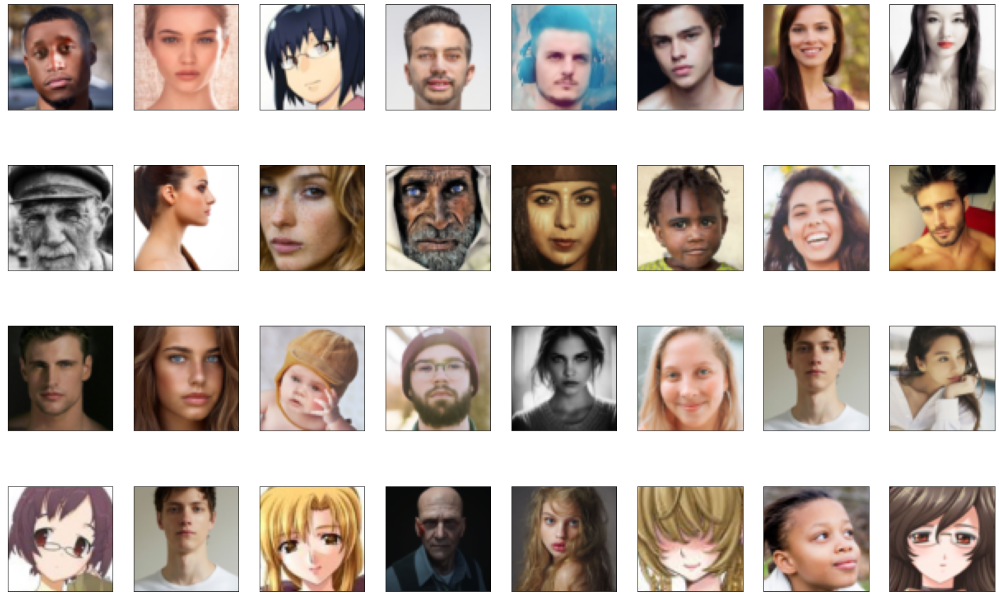

In [ ]:
x = next(iter(train_loader))

fig = plt.figure(figsize=(25, 16))
for ii, img in enumerate(x):
    ax = fig.add_subplot(4, 8, ii + 1, xticks=[], yticks=[])
    
    img = img.numpy().transpose(1, 2, 0)
    plt.imshow((img+1.)/2.)

##Model

In [ ]:
class VAE(nn.Module):
    def __init__(self, latent_dim=128, no_of_sample=10, batch_size=32, channels=3):
        super(VAE, self).__init__()
        
        self.no_of_sample = no_of_sample
        self.batch_size = batch_size
        self.channels = channels
        self.latent_dim = latent_dim
        
        
        # Encoder
        def convlayer_enc(n_input, n_output, k_size=4, stride=2, padding=1, bn=False):
            block = [nn.Conv2d(n_input, n_output, kernel_size=k_size, stride=stride, padding=padding, bias=False)]
            if bn:
                block.append(nn.BatchNorm2d(n_output))
            block.append(nn.LeakyReLU(0.2, inplace=True))
            return block
        
        self.encoder = nn.Sequential(
            *convlayer_enc(self.channels, 64, 4, 2, 2),               # (64, 32, 32)
            *convlayer_enc(64, 128, 4, 2, 2),                         # (128, 16, 16)
            *convlayer_enc(128, 256, 4, 2, 2, bn=True),               # (256, 8, 8)
            *convlayer_enc(256, 512, 4, 2, 2, bn=True),               # (512, 4, 4)
            nn.Conv2d(512, self.latent_dim*2, 4, 1, 1, bias=False),   # (latent_dim*2, 4, 4)
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        
        # Decoder
        def convlayer_dec(n_input, n_output, k_size=4, stride=2, padding=0):
            block = [
                nn.ConvTranspose2d(n_input, n_output, kernel_size=k_size, stride=stride, padding=padding, bias=False),
                nn.BatchNorm2d(n_output),
                nn.ReLU(inplace=True),
            ]
            return block
        
        self.decoder = nn.Sequential(
            *convlayer_dec(self.latent_dim, 512, 4, 2, 1),           # (512, 8, 8)
            *convlayer_dec(512, 256, 4, 2, 1),                       # (256, 16, 16)
            *convlayer_dec(256, 128, 4, 2, 1),                       # (128, 32, 32)
            *convlayer_dec(128, 64, 4, 2, 1),                        # (64, 64, 64)
            nn.ConvTranspose2d(64, self.channels, 3, 1, 1),          # (3, 64, 64)
            nn.Sigmoid()
        )

    def encode(self, x):
        '''return mu_z and logvar_z'''
        x = self.encoder(x)
        return x[:, :self.latent_dim, :, :], x[:, self.latent_dim:, :, :]
    
    def decode(self, z):
        z = self.decoder(z)
        return z.view(-1, 3 * 64 * 64)

    def reparameterize(self, mu, logvar):
        if self.training:
            # multiply log variance with 0.5, then in-place exponent
            # yielding the standard deviation

            sample_z = []
            for _ in range(self.no_of_sample):
                std = logvar.mul(0.5).exp_()
                eps = Variable(std.data.new(std.size()).normal_())
                sample_z.append(eps.mul(std).add_(mu))
            return sample_z
        
        else:
            return mu

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        
        if self.training:
            return [self.decode(z) for z in z], mu, logvar
        else:
            return self.decode(z), mu, logvar

    def loss_function(self, recon_x, x, mu, logvar):

        if self.training:
            BCE = 0
            for recon_x_one in recon_x:
                BCE += F.binary_cross_entropy(recon_x_one, x.view(-1, 3 * 64 * 64))
            BCE /= len(recon_x)
        else:
            BCE = F.binary_cross_entropy(recon_x, x.view(-1, 3 * 64 * 64))

        KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
        KLD /= self.batch_size * 3 * 64 * 64

        return BCE + KLD

## Training

In [ ]:
lr = 0.002
epochs = 15
latent_dim = 32

model = VAE(latent_dim, batch_size=batch_size).to(device)
optimizer = optim.Adam(model.parameters(), lr=lr)

Epoch 1 start
tensor(-10.0431, device='cuda:0', grad_fn=<DivBackward0>)


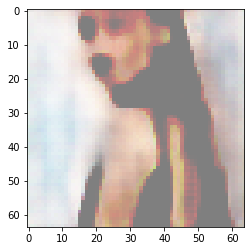

Epoch 2 start
tensor(-13.6568, device='cuda:0', grad_fn=<DivBackward0>)


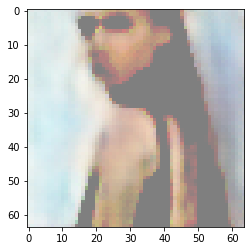

Epoch 3 start
tensor(-14.5724, device='cuda:0', grad_fn=<DivBackward0>)


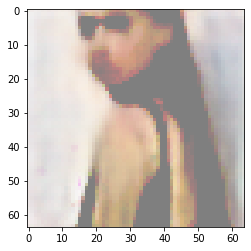

Epoch 4 start
tensor(-15.0098, device='cuda:0', grad_fn=<DivBackward0>)


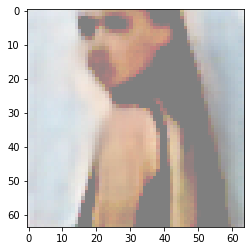

Epoch 5 start
tensor(-15.2571, device='cuda:0', grad_fn=<DivBackward0>)


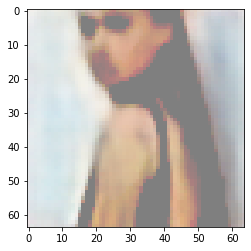

Epoch 6 start
tensor(-15.4114, device='cuda:0', grad_fn=<DivBackward0>)


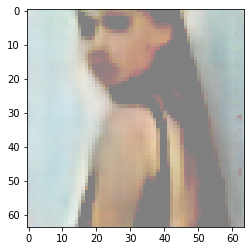

Epoch 7 start
tensor(-15.5053, device='cuda:0', grad_fn=<DivBackward0>)


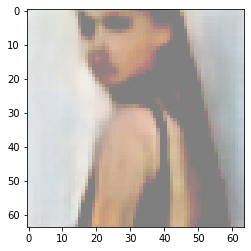

Epoch 8 start
tensor(-15.5765, device='cuda:0', grad_fn=<DivBackward0>)


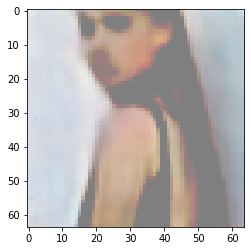

Epoch 9 start
tensor(-15.6292, device='cuda:0', grad_fn=<DivBackward0>)


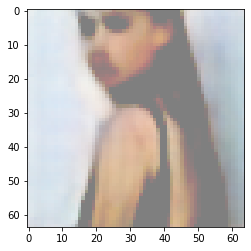

Epoch 10 start
tensor(-15.6682, device='cuda:0', grad_fn=<DivBackward0>)


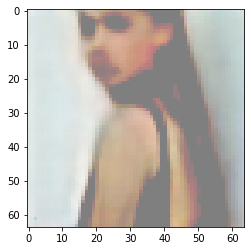

Epoch 11 start


KeyboardInterrupt: ignored

In [ ]:
for epoch in range(1, epochs+1):
    model.train()
    print(f'Epoch {epoch} start')
    
    loss_m = 0
    i = 0
    for batch_idx, data in enumerate(train_loader):
        data = data.to(device)
        optimizer.zero_grad()

        recon_batch, mu, logvar = model(data)
        loss = model.loss_function(recon_batch, data, mu, logvar)

        loss.backward()
        optimizer.step()
        loss_m += loss
        i += 1
      
    print(loss_m/i)
    model.eval()
    recon_img, _, _ = model(x[1:2].to(device))
    img = recon_img.view(3, 64, 64).detach().cpu().numpy().transpose(1, 2, 0)
    
    plt.imshow((img+1.)/2.)
    plt.show()

##Reconstruction visualisation

torch.Size([32, 3, 64, 64])


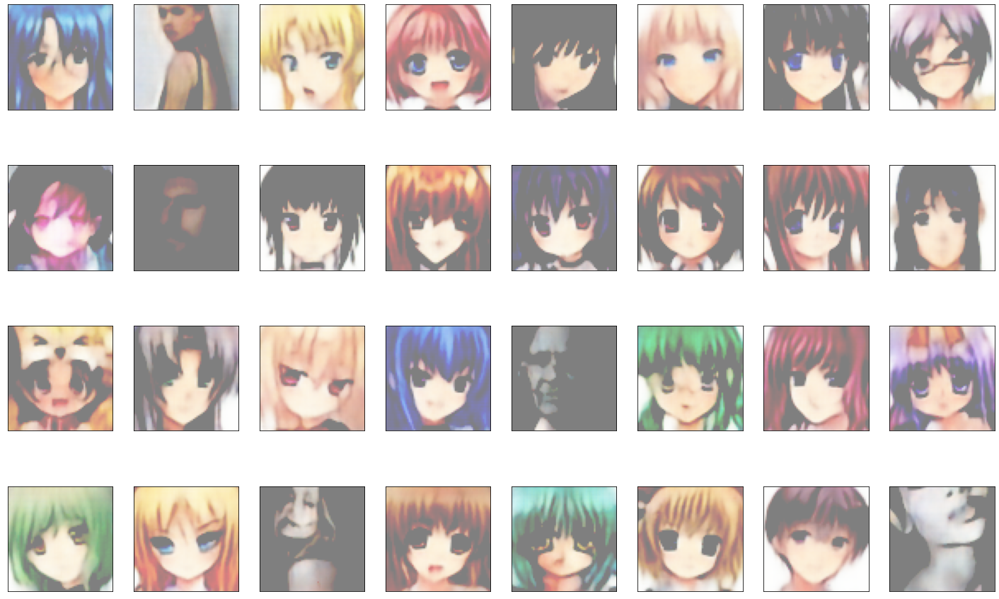

In [ ]:
print(x.shape)
model.eval()
reconstructed, mu, _ = model(x.to(device))
reconstructed = reconstructed.view(-1, 3, 64, 64).detach().cpu().numpy().transpose(0, 2, 3, 1)

fig = plt.figure(figsize=(25, 16))
for ii, img in enumerate(reconstructed):
    ax = fig.add_subplot(4, 8, ii + 1, xticks=[], yticks=[])
    plt.imshow((img+1.)/2.)

## Tensorboard embedding space visualisation
Visualisation of the faces projections in the embedding space.
We can notice how clustered the faces groups are.

In [ ]:
import tensorflow as tf
import tensorboard as tb
tf.io.gfile = tb.compat.tensorflow_stub.io.gfile

def select_n_random(dataset, model,n=200):
    '''
    Selects n random datapoints and their corresponding labels from a dataset
    '''
    model.eval()

    perm = torch.randperm(len(dataset))
    labels = []
    data=[]
    for p in range(n):
        labels.append(dataset.labels[perm[p]])
        mu, _ = model.encode(dataset[perm[p]].unsqueeze(0).to(device))
        data.append(mu)
    return torch.stack(data).squeeze(1), labels

# select random images and their target indices
encodings, labels = select_n_random(train_dataset, model, 800)

# get the class labels for each image
classes = {'real':0,
           'manga':1}
class_labels = [classes[lab] for lab in labels]
#print(class_labels)
#print(encodings.shape)
# log embeddings
features = encodings.view(-1, 32 * 16)
#print(features.shape)
writer.add_embedding(features,
                    metadata=class_labels)

writer.close()

In [ ]:
real_features = []
manga_features = []
for i in range(features.shape[0]):
  if class_labels[i] == 0:
    real_features.append(features[i,:])
  else:
    manga_features.append(features[i,:])

real_features = torch.stack(real_features)
manga_features = torch.stack(manga_features)

real_barycenters = torch.mean(real_features, dim=0)
manga_barycenters = torch.mean(manga_features, dim=0)
print(real_barycenters)

torch.Size([137, 512])
tensor([ 2.1507e-03,  1.2001e-01,  1.1766e-01,  5.0734e-02, -5.7699e-03,
         4.5252e-02,  2.4061e-01,  2.2248e-01, -9.8209e-02, -2.4117e-02,
         1.7076e-01,  7.6883e-02,  1.3222e-02, -2.0060e-02,  3.9585e-02,
         8.6018e-02,  4.7255e-02,  2.8610e-01,  2.3580e-01,  1.2510e-01,
         5.3093e-02,  2.4319e-01,  1.8338e-01,  1.5168e-01,  6.9081e-02,
         3.0309e-01,  1.1151e-01,  1.7396e-01, -4.3208e-02,  2.3260e-01,
         9.7814e-03,  7.3788e-02,  1.5145e-01,  8.5998e-02,  3.9951e-01,
        -1.1595e-01,  3.3031e-01, -5.1809e-01,  2.3038e-02, -1.0049e-01,
         2.6507e-01, -2.8170e-01, -1.5908e-02, -9.5619e-03,  9.8127e-02,
         2.3460e-02,  8.2526e-02, -1.4308e-02,  5.1965e-02, -4.3862e-02,
         1.6465e-01,  8.1684e-04,  4.5678e-04,  1.2703e-02,  1.2752e-01,
        -7.1828e-02, -2.8260e-02,  5.8569e-02,  1.1147e-01,  1.2329e-01,
        -2.3534e-02, -1.9508e-01,  1.1399e-01, -7.4612e-02, -1.1690e-01,
        -1.1832e-01,  2.2006

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
tensorboard --logdir=runs

Reusing TensorBoard on port 6006 (pid 1136), started 0:01:14 ago. (Use '!kill 1136' to kill it.)

<IPython.core.display.Javascript object>

## Faces interpolations
Don't really works for real faces but interesting result concerning manga faces

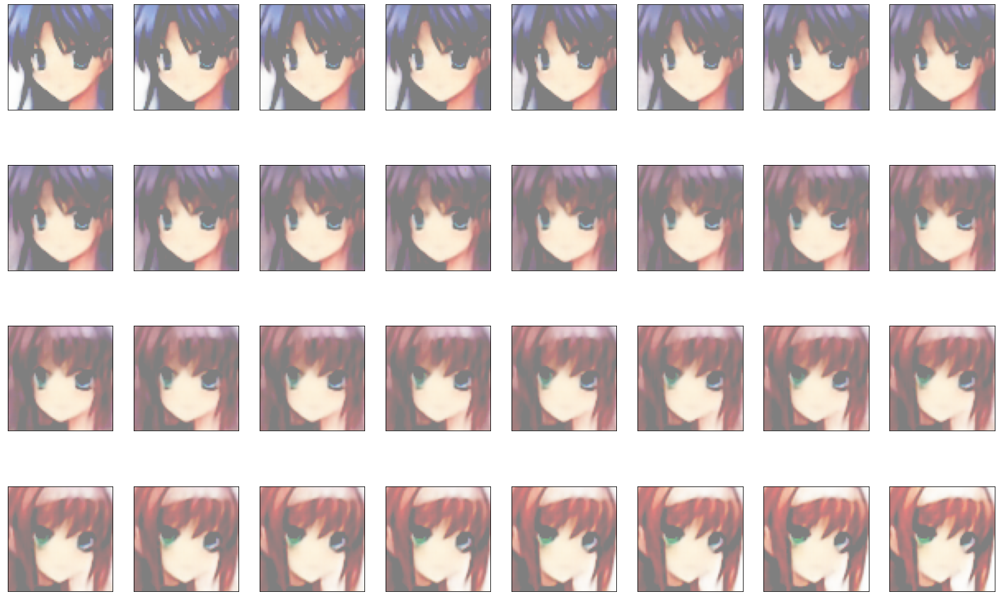

In [ ]:
id1 = 8
id2 = 25
import random

id1 = random.randint(0,len(train_dataset))
id2 = random.randint(0,len(train_dataset))


model.eval()
reconstructed, mu, _ = model(torch.stack([train_dataset[id1],train_dataset[id2]]).to(device))
dz = (mu[1] - mu[0]) / 31
walk = Variable(torch.randn(32, latent_dim, 4, 4)).to(device)
walk[0] = mu[0]

for i in range(1, 32):
    walk[i] = walk[i-1] + dz
walk = model.decoder(walk).detach().cpu().numpy().transpose(0, 2, 3, 1)

fig = plt.figure(figsize=(25, 16))
for ii, img in enumerate(walk):
    ax = fig.add_subplot(4, 8, ii + 1, xticks=[], yticks=[])
    plt.imshow((img+1.)/2.)

In [ ]:
 real_barycenters.view(-1,32,4,4).repeat(32, 1, 1, 1).shape

torch.Size([32, 32, 4, 4])

## Random manga face generation
add noise from the average manga face embedding and reconstruct an image

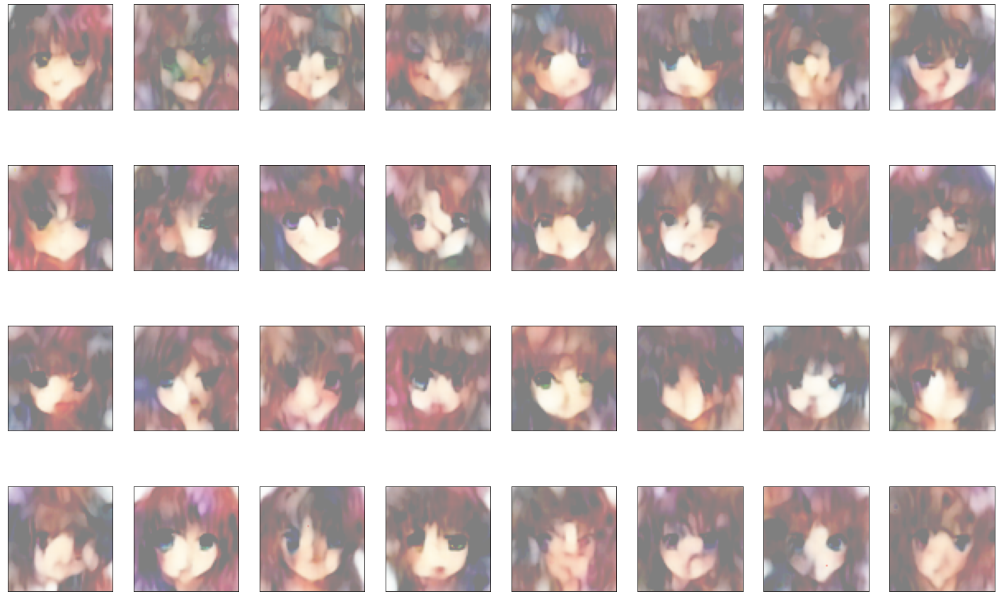

In [ ]:
samples = Variable(torch.randn(32, latent_dim, 4, 4)).to(device)
samples = manga_barycenters.view(-1,32,4,4).repeat(32, 1, 1, 1) + samples *0.6
samples = model.decoder(samples).detach().cpu().numpy().transpose(0, 2, 3, 1)

fig = plt.figure(figsize=(25, 16))
for ii, img in enumerate(samples):
    ax = fig.add_subplot(4, 8, ii + 1, xticks=[], yticks=[])
    plt.imshow((img+1.)/2.)